# Test gait_evaluate.py

In [1]:
import os


if "original_dir" in globals():
    # current_dir = os.path.dirname(original_dir)
    current_dir = original_dir
    os.chdir(current_dir)
    print(f"Current directorys: {current_dir}")
else:
    original_dir = os.getcwd()
    print(f"Current directory: {original_dir}")

os.chdir("../../../../")
print(f"Changed directory: {os.getcwd()}")


Current directory: d:\northeastern\neu_dev\myo_assist_dev\myosuite\rl_train\myoassist\analyzer
Changed directory: d:\northeastern\neu_dev\myo_assist_dev


In [ ]:
log_folder_name = input("folder_name") 
if log_folder_name == "":
    log_folder_name = "train_session_20250306-204850_nodephy2"
import os
from myosuite.rl_train.myoassist.utils.handlers.train_log_handler import TrainLogHandler
from myosuite.rl_train.myoassist.utils.handlers.train_checkpoint_data_imitation import ImitationTrainCheckpointData
log_dir = os.path.join("train_logs","selected",log_folder_name)

log_handler = TrainLogHandler(log_dir,"session_name")
log_handler.load_log_data(ImitationTrainCheckpointData)


from myosuite.rl_train.myoassist.analyzer.train_analyzer import TrainAnalyzer
train_analyzer = TrainAnalyzer()
train_analyzer.analyze_in_sequence(log_dir, show_plot=True)

In [48]:
log_folder_name = input("folder_name") 
if log_folder_name == "":
    log_folder_name = "train_session_20250306-204850_nodephy2"
import os
from myosuite.rl_train.myoassist.utils.handlers.train_log_handler import TrainLogHandler
from myosuite.rl_train.myoassist.utils.handlers.train_checkpoint_data_imitation import ImitationTrainCheckpointData
log_dir = os.path.join("train_logs","selected",log_folder_name)
analyze_result_dir = os.path.join(log_dir,"analyze_results")
if not os.path.exists(analyze_result_dir):
    os.makedirs(analyze_result_dir)

log_handler = TrainLogHandler(log_dir,"session_name")
log_handler.load_log_data(ImitationTrainCheckpointData)


JSONDecodeError: Expecting property name enclosed in double quotes: line 130903 column 21 (char 6553768)

In [25]:
from myosuite.rl_train.myoassist.utils.data_types import DictionableDataclass
DictionableDataclass.to_dict(log_handler.log_datas[-1])

{'approx_kl': 0.015061532147228718,
 'clip_fraction': 0.1260528564453125,
 'clip_range': 0.2,
 'clip_range_vf': 100.0,
 'entropy_loss': 4.780296981334686,
 'explained_variance': 0.8865394592285156,
 'learning_rate': 0.0001,
 'loss': 0.01350901834666729,
 'n_updates': 669448,
 'policy_gradient_loss': -0.0042511718202149495,
 'std': 0.5012420415878296,
 'value_loss': 0.03783455491065979,
 'num_timesteps': 804274176,
 'average_num_timestep': 893.4788732394367,
 'average_reward_per_episode': 21.534127265145464,
 'average_reward_dict_per_episode': [{'forward_reward': 7.008467475135808,
   'muscle_activation_penalize': 13.505329585791529,
   'muscle_activation_diff_penalize': 22.943570001517678,
   'foot_force_penalize': 19.623118744745256,
   'muscle_activation_penalty_per_step': 0.0,
   'average_velocity_per_step': 0.0,
   'footstep_delta_time': 0.0,
   'qpos_imitation_rewards': 0.0,
   'qvel_imitation_rewards': 0.0,
   'end_effector_imitation_reward': 26.46666666666671,
   'sparse': 0.0,


# Plot traing logs

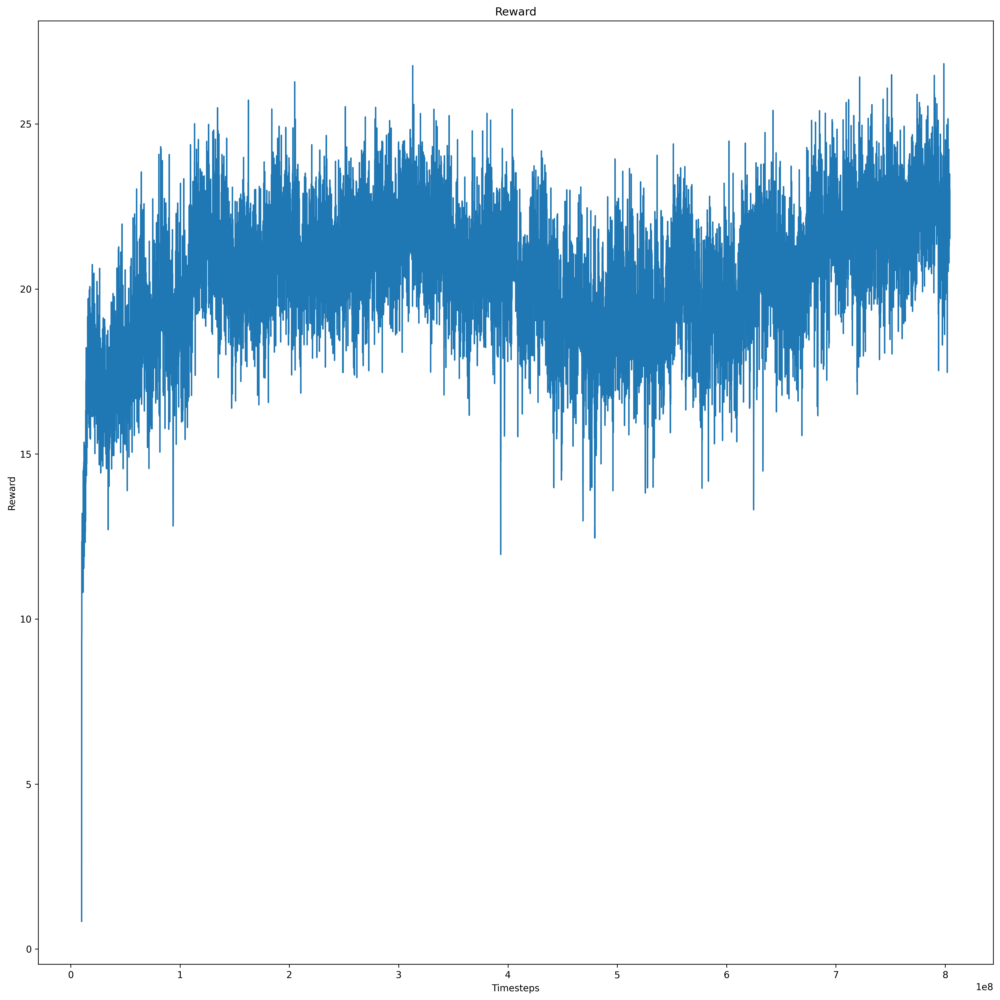

In [26]:
import sys
sys.modules.pop('package.train_log_analyzer', None)
from myosuite.rl_train.myoassist.analyzer.train_log_analyzer import TrainLogAnalyzer
train_log_analyzer = TrainLogAnalyzer(log_handler)
train_log_analyzer.plot_reward(result_dir=analyze_result_dir)


d:\northeastern\neu_dev\myo_assist_dev\myosuite\rl_train\myoassist\analyzer\train_log_analyzer.py:51: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[0].legend()
d:\northeastern\neu_dev\myo_assist_dev\myosuite\rl_train\myoassist\analyzer\train_log_analyzer.py:55: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  axes[1].legend()


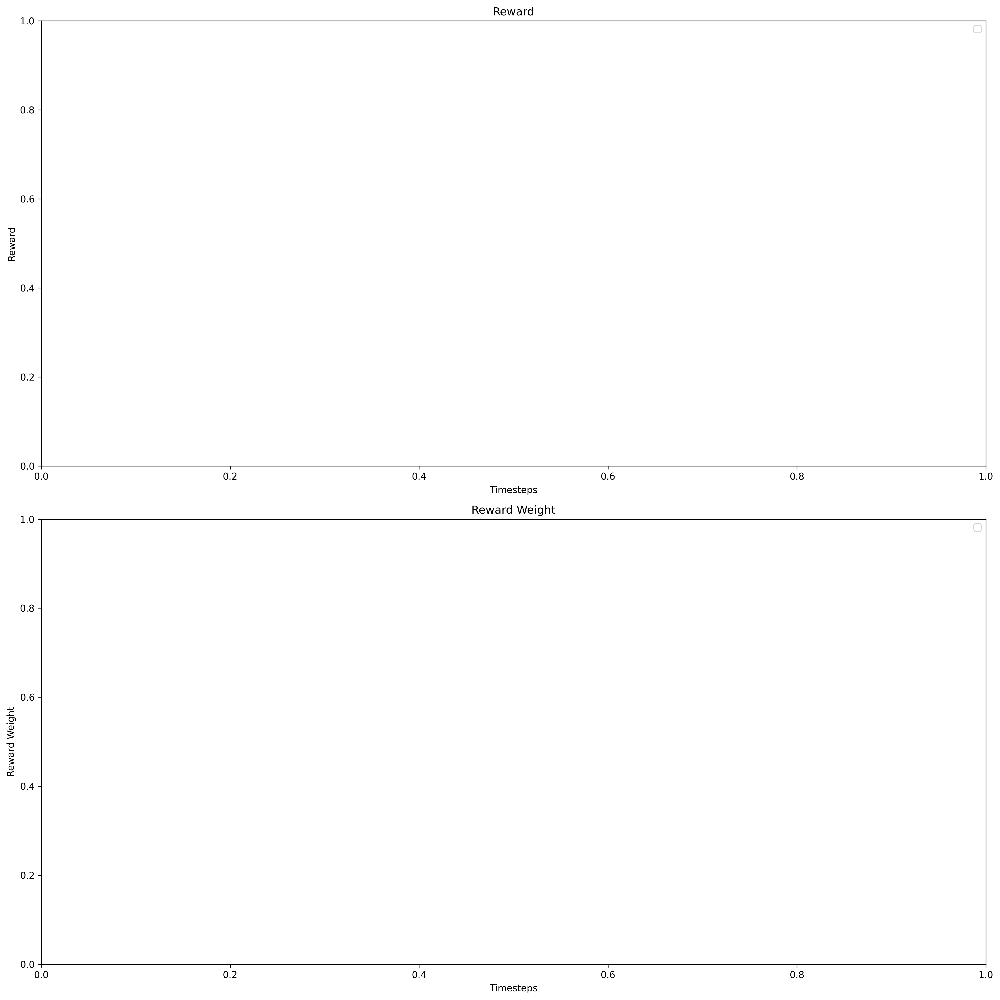

In [27]:
train_log_analyzer.plot_reward_weights(result_dir=analyze_result_dir)


## Load session config


In [28]:
import json
# from package.config import TrainSessionConfigBase
from myosuite.envs.myoassist.myo_leg_18_imitation import ImitationTrainSessionConfig
from myosuite.rl_train.myoassist.utils.data_types import DictionableDataclass
with open(os.path.join(log_dir, "session_config.json"), 'r') as f:
    config_dict = json.load(f)
config = DictionableDataclass.create(ImitationTrainSessionConfig, config_dict)


In [29]:
from myosuite.rl_train.myoassist.utils.config_imitation import ImitationTrainSessionConfig
from myosuite.envs.myoassist import myo_leg_18_guided
# from myosuite.envs.myoassist import myo_leg_18_reward_per_step

if config.env_params.env_id == 'myoLeg18-v0':
    config = DictionableDataclass.create(config.TrainSessionConfigBase, config_dict)
elif config.env_params.env_id in ['myoLeg18Imitation-v0', 'myoLeg18ImitationDephy-v0']:
    # print("Imitation train session config")
    config = DictionableDataclass.create(ImitationTrainSessionConfig, config_dict)
    # print("\nAll fields in RewardWeights:")
    # for field in fields(config.env_params.reward_keys_and_weights):
    #     print(f"{field.name}: {getattr(config.env_params.reward_keys_and_weights, field.name)}")
elif config.env_params.env_id == 'myoLeg18Guided-v0':
    config = DictionableDataclass.create(myo_leg_18_guided.GuidedTrainSessionConfig, config_dict)
# elif config.env_params.env_id == 'myoLeg18RewardPerStep-v0':
#     config = DictionableDataclass.create(myo_leg_18_reward_per_step.RewardPerStepTrainSessionConfig, config_dict)

In [30]:
config.env_params.min_target_velocity = 1.0
config.env_params.max_target_velocity = 2.0
from myosuite.envs.myoassist.myo_leg_18_base import MyoLeg18Base
velocity_mode = MyoLeg18Base.VelocityMode.SINUSOIDAL
target_velocity_period = 3

In [31]:


gait_data_name = f"{log_handler.session_name}_gait_evaluated_data.json"
if os.path.exists(os.path.join(analyze_result_dir, gait_data_name)):
    user_input = input(f"Regenerate evaluate data? ({gait_data_name}) (y/n(anything))")
else:
    user_input = "y"
is_regen_evaluating_data = True if user_input == "y" else False

from myosuite.rl_train.myoassist.analyzer.gait_evaluate import ImitationGaitEvaluator
gait_evaluator = ImitationGaitEvaluator(log_handler, config)
gait_evaluator.load_reference_data()
gait_evaluator.initialize_env()
if is_regen_evaluating_data:
    gait_data_path = gait_evaluator.evaluate(result_dir=analyze_result_dir,
                                            file_name=gait_data_name,
                                            velocity_mode=velocity_mode,
                                            target_velocity_period=target_velocity_period,
                                            )
else:
    gait_data_path = os.path.join(analyze_result_dir, gait_data_name)
    

===============REFERENCE DATA LOADING================
===============REFERENCE DATA LOADING DONE================
Loading reference data from myosuite/simhive/myoassist_sim/reference_motions/neumove_02-constspeed_reduced_humanoid.npz
config.env_params.env_id='myoLeg18Imitation-v0'
=================environment seed: 1234=====================
=================environment model_path: myosuite/simhive/myoassist_sim/gait14dof22musc_cvt3_Right_Toeless_2D.xml=====================
===============================PARAMETERS=============================
self._reward_keys_and_weights=ImitationTrainSessionConfig.EnvParams.RewardWeights(forward_reward=1.0, muscle_activation_penalize=0.1, muscle_activation_diff_penalize=0.1, footstep_delta_time=0.0, average_velocity_per_step=0.0, muscle_activation_penalty_per_step=0.0, foot_force_penalize=0.1, qpos_imitation_rewards={'pelvis_ty': 0.0, 'pelvis_tilt': 0.0, 'hip_flexion_l': 0.0, 'hip_flexion_r': 0.0, 'knee_angle_l': 0.0, 'knee_angle_r': 0.0, 'ankle_angle

In [32]:
gait_evaluator.env.is_evaluate_mode

True

# Test gait_analyze.py - GaitAnalyzer

In [33]:
import sys
sys.modules.pop('package.gait_analyze', None)
sys.modules.pop('package.gait_evaluate', None)
from myosuite.rl_train.myoassist.analyzer.gait_analyze import GaitAnalyzer
from myosuite.rl_train.myoassist.analyzer.gait_evaluate import GaitData


gait_data = GaitData()
gait_data.read_json_data(gait_data_path)
import json 
with open(os.path.join("myosuite/simhive/myoassist_sim/reference_data_segmented/02-constspeed_reduced_humanoid_segmented.json"), 'r') as f:
    segmented_ref_data = json.load(f)
gait_analyzer = GaitAnalyzer(gait_data, segmented_ref_data)

self.gait_data.series_data.keys()=dict_keys(['joint_data', 'actuator_data', 'sensor_data', 'physics_data', 'target_data'])


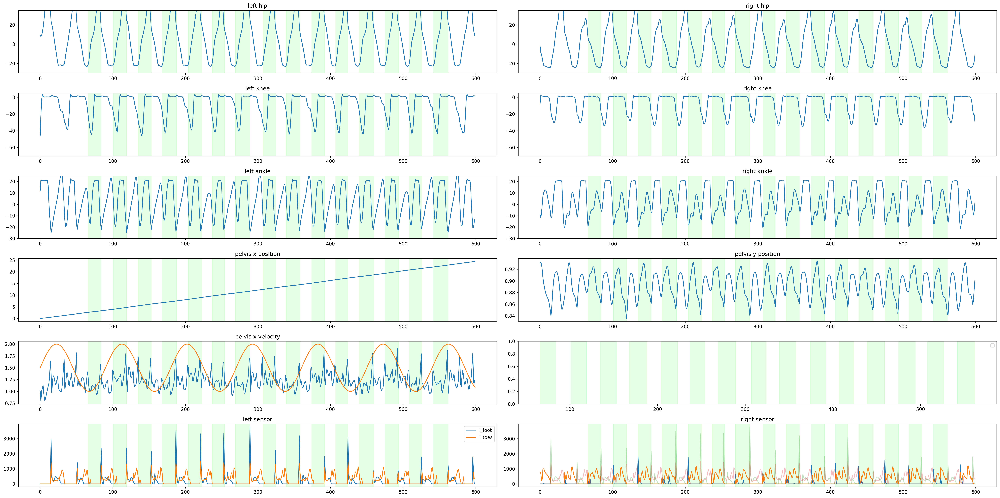

In [34]:
gait_analyzer.plot_entire_result(result_dir=analyze_result_dir,is_right_foot_based=True)

self.gait_data.series_data.keys()=dict_keys(['joint_data', 'actuator_data', 'sensor_data', 'physics_data', 'target_data'])


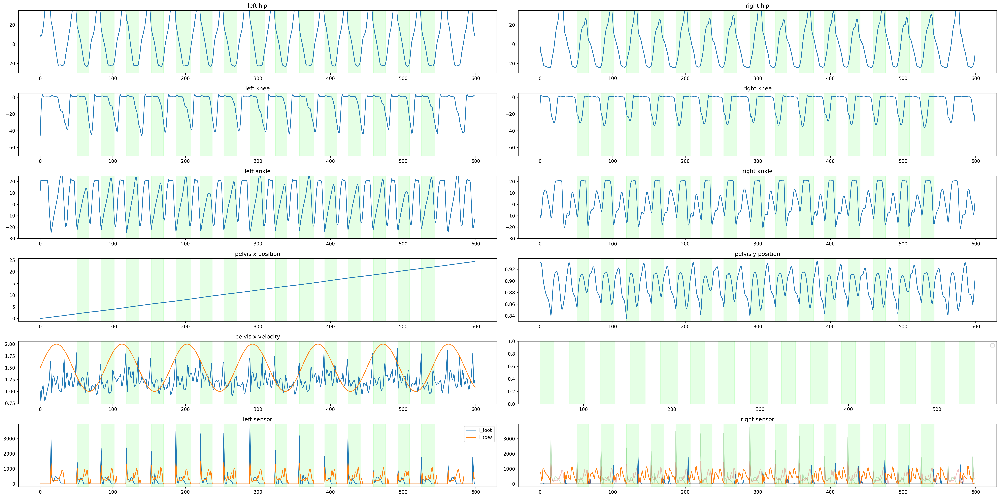

In [35]:
gait_analyzer.plot_entire_result(result_dir=analyze_result_dir,is_right_foot_based=False)

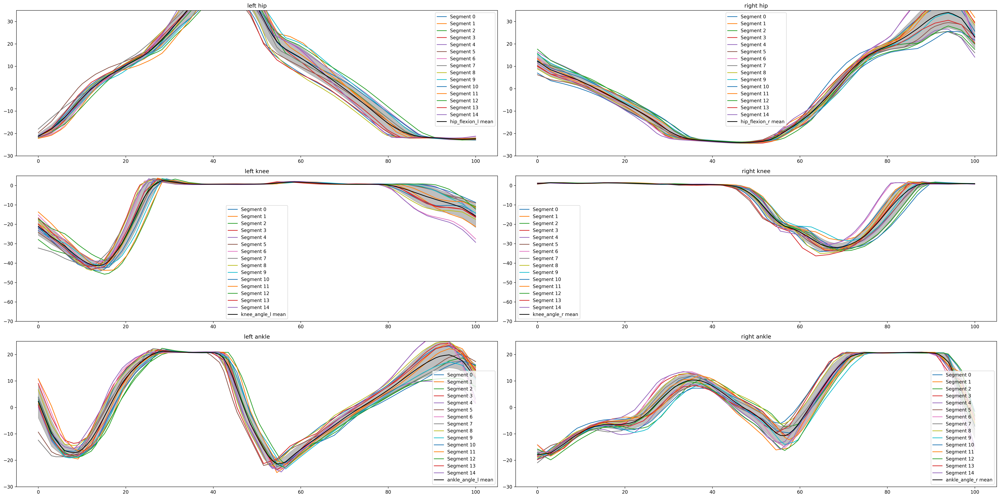

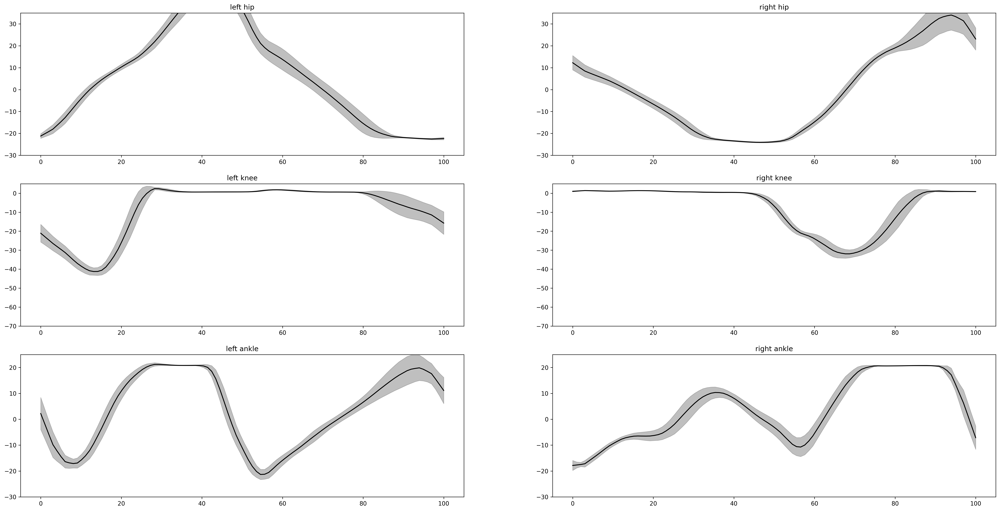

In [36]:
gait_analyzer.plot_segmented_kinematics_result(result_dir=analyze_result_dir)

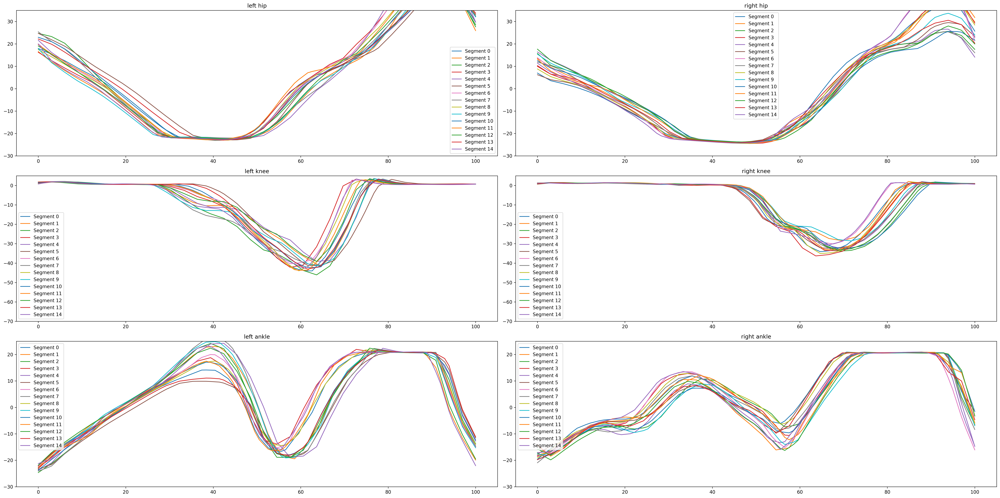

DEBUG:: joint='hip_flexion_l', data.shape=(15, 100)
DEBUG:: joint='hip_flexion_r', data.shape=(15, 100)
DEBUG:: joint='knee_angle_l', data.shape=(15, 100)
DEBUG:: joint='knee_angle_r', data.shape=(15, 100)
DEBUG:: joint='ankle_angle_l', data.shape=(15, 100)
DEBUG:: joint='ankle_angle_r', data.shape=(15, 100)


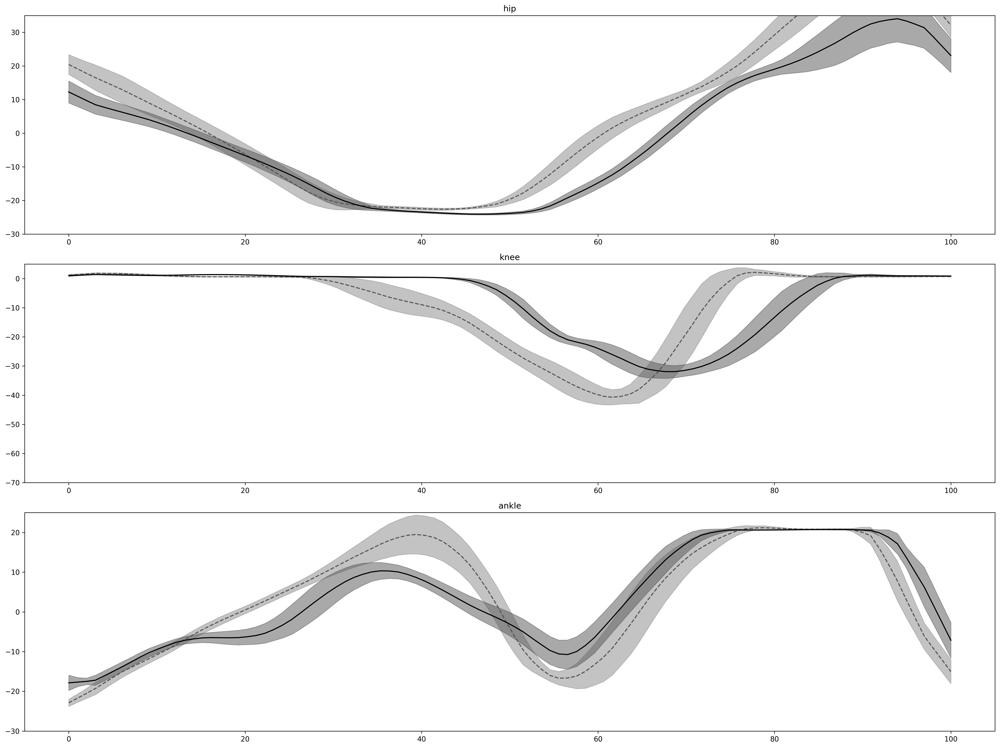

In [37]:
gait_analyzer.plot_left_right_comparison(result_dir=analyze_result_dir)

## compare with reference data

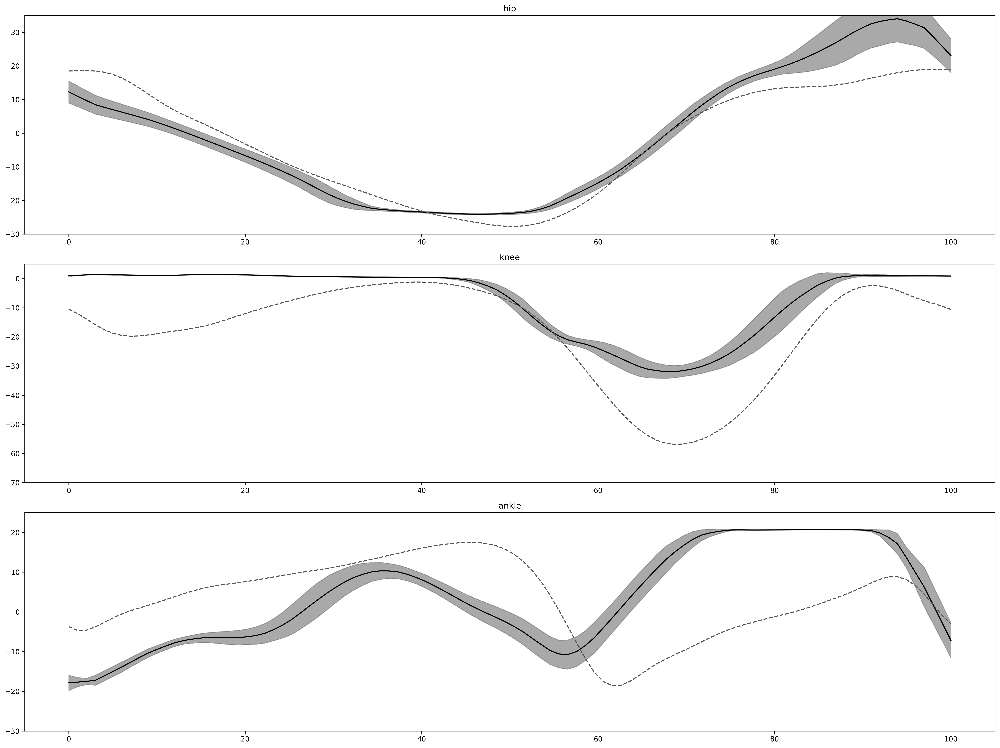

In [38]:
## compare with reference data
gait_analyzer.plot_right_ref_comparison(result_dir=analyze_result_dir)


# Contact data

In [39]:
# Contact data
print(len(gait_data.series_data["physics_data"]["contacts"]["data"]))
contact_data_num = 0
contact_object_name_set = set()
for contact_data_list in gait_data.series_data["physics_data"]["contacts"]["data"]:
    contact_data_num += len(contact_data_list)
    for contact_data in contact_data_list:
        contact_object_name_set.add(contact_data["geom1"])
        contact_object_name_set.add(contact_data["geom2"])

print(f"average contact data per frame: {contact_data_num/len(gait_data.series_data['physics_data']['contacts']['data'])}")
print(contact_object_name_set)


600
average contact data per frame: 2.225
{'ground-plane', 'calcn_r_geom_1', 'calcn_l_geom_1'}


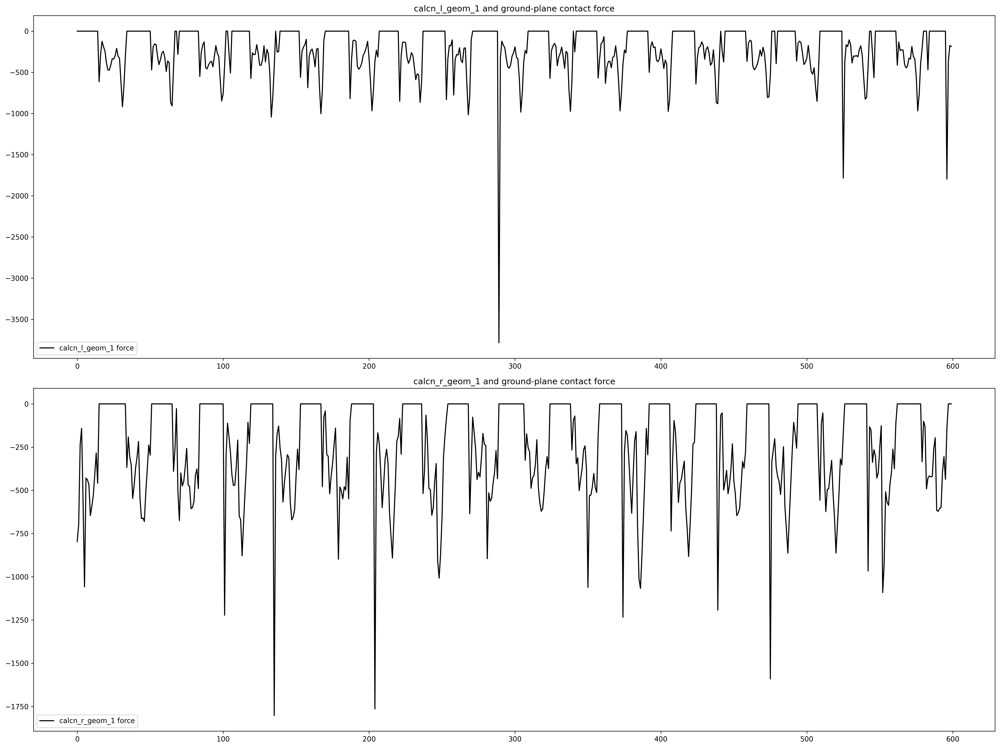

In [40]:
gait_analyzer.plot_contact_data(result_dir=analyze_result_dir)

# Muscle data

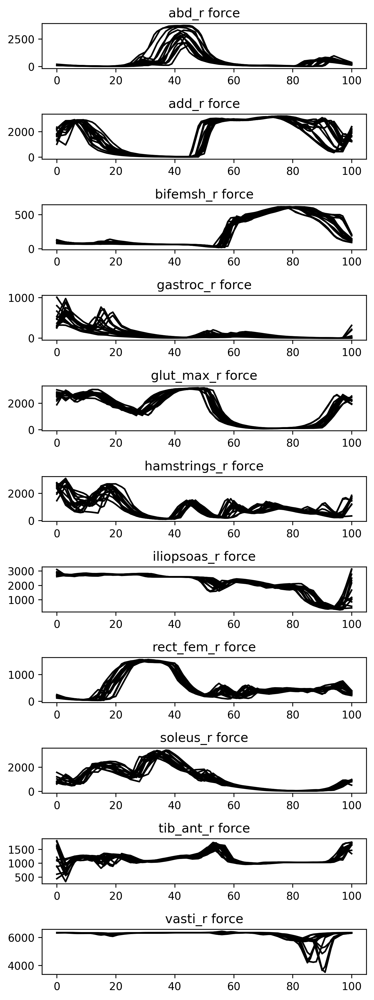

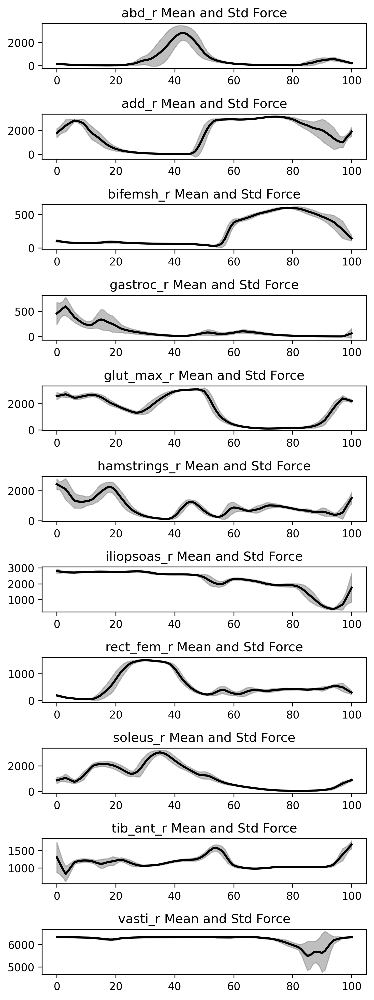

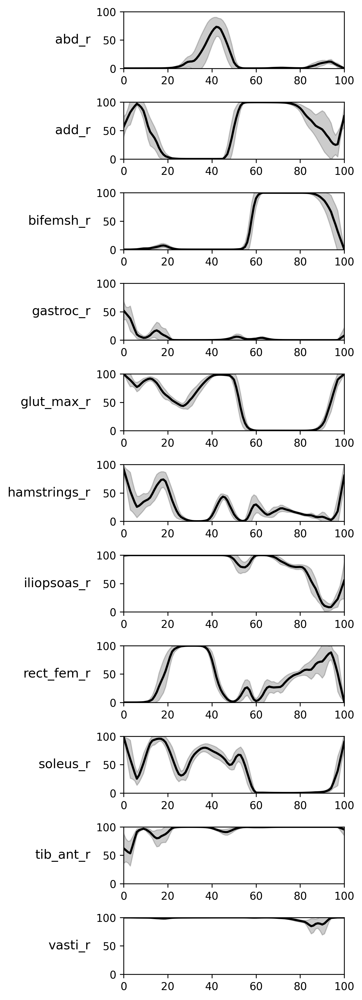

In [41]:
gait_analyzer.plot_segmented_muscle_data(result_dir=analyze_result_dir, is_plot_right=True)

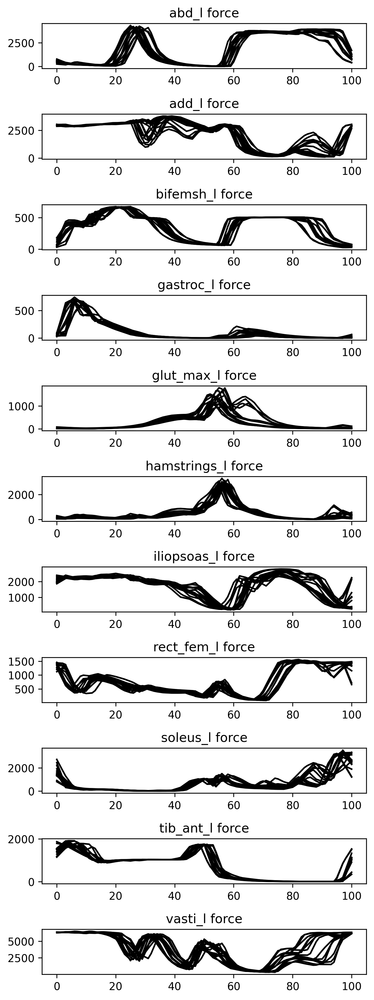

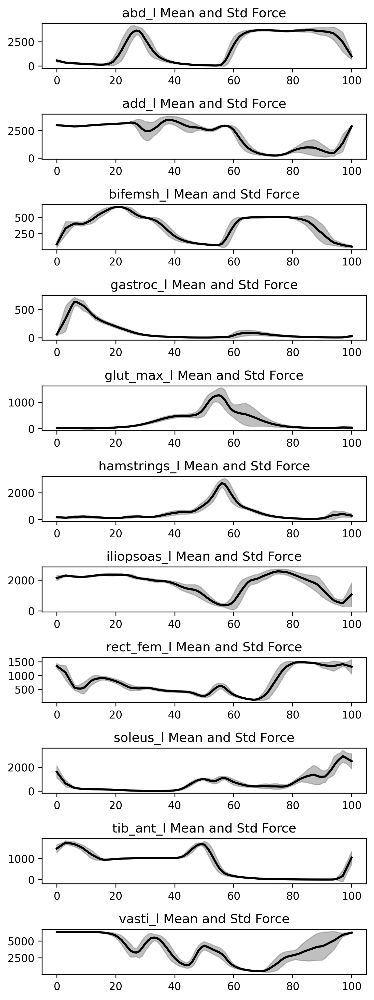

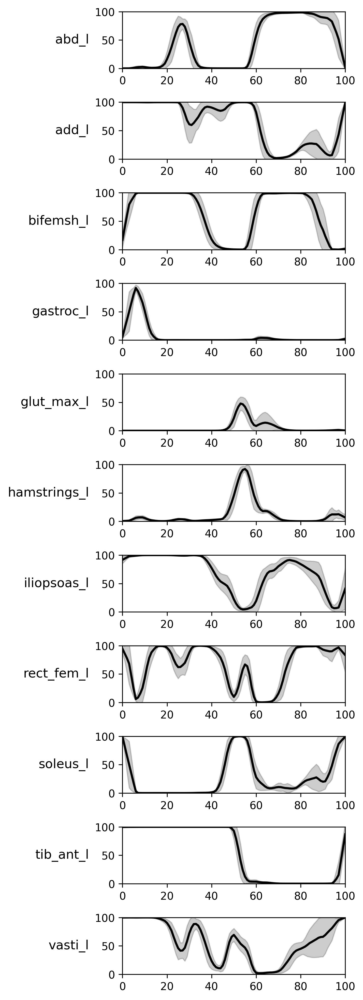

In [42]:
gait_analyzer.plot_segmented_muscle_data(result_dir=analyze_result_dir, is_plot_right=False)


# Test gait_evaluate.py - GaitEvaluater replay


In [43]:
from importlib import reload
import myosuite.rl_train.myoassist.analyzer.gait_evaluate
reload(myosuite.rl_train.myoassist.analyzer.gait_evaluate)

from myosuite.rl_train.myoassist.analyzer.gait_evaluate import ImitationGaitEvaluator
gait_evaluator = ImitationGaitEvaluator(log_handler, config)
gait_evaluator.reference_data = gait_evaluator.load_reference_data()#Isnt it weird?
gait_evaluator.initialize_env()

===============REFERENCE DATA LOADING================
===============REFERENCE DATA LOADING DONE================
Loading reference data from myosuite/simhive/myoassist_sim/reference_motions/neumove_02-constspeed_reduced_humanoid.npz
config.env_params.env_id='myoLeg18Imitation-v0'
=================environment seed: 1234=====================
=================environment model_path: myosuite/simhive/myoassist_sim/gait14dof22musc_cvt3_Right_Toeless_2D.xml=====================
===============================PARAMETERS=============================
self._reward_keys_and_weights=ImitationTrainSessionConfig.EnvParams.RewardWeights(forward_reward=1.0, muscle_activation_penalize=0.1, muscle_activation_diff_penalize=0.1, footstep_delta_time=0.0, average_velocity_per_step=0.0, muscle_activation_penalty_per_step=0.0, foot_force_penalize=0.1, qpos_imitation_rewards={'pelvis_ty': 0.0, 'pelvis_tilt': 0.0, 'hip_flexion_l': 0.0, 'hip_flexion_r': 0.0, 'knee_angle_l': 0.0, 'knee_angle_r': 0.0, 'ankle_angle

In [44]:
max_timestep=600
idx = 0
for cam_type in ["average_speed", "follow"]:
    for act_viz in [True, False]:
        for cam_distance in [2.5, 5.0]:
            file_name = f'replay_{idx:02}_{"act" if act_viz else "noact"}_{cam_type}_{cam_distance}.mp4'
            print(f"Generating {file_name}...")
            frames = gait_evaluator.replay(gait_data_path, os.path.join(analyze_result_dir, file_name),
                                            cam_distance=cam_distance,
                                            max_time_step=max_timestep,
                                            use_activation_visualization=act_viz,
                                            cam_type=cam_type,
                                            use_realtime_floating=False
                                            )
            idx += 1
        

Generating replay_00_act_average_speed_2.5.mp4...
Generating replay_01_act_average_speed_5.0.mp4...
Generating replay_02_noact_average_speed_2.5.mp4...
Generating replay_03_noact_average_speed_5.0.mp4...
Generating replay_04_act_follow_2.5.mp4...
Generating replay_05_act_follow_5.0.mp4...
Generating replay_06_noact_follow_2.5.mp4...
Generating replay_07_noact_follow_5.0.mp4...


In [ ]:
import mediapy
mediapy.show_video(frames, fps=30)


In [46]:
import mujoco
mujoco.__version__

'3.1.5'